# Who does viral pneumonia hit the hardest? Using patient features to predict 90-day mortality risk

## Background
On the last day of 2019, a novel coronavirus (2019-nCoV) outbreak took China by storm. Two months later on January 30, The World Health Organization declared it as a "Public Health Emergency of International Concern", which is the highest level of alert for an infectious disease. As of February 6, 28,368 cases have been confirmed worldwide, among which 566 died and 1,428 recovered (These numbers might change by the minute; live updates are available on [Worldometer](https://www.worldometers.info/coronavirus/)).

**Who does the new virus hit the hardest?** So far, only two peer-reviewed studies, both published in *The Lancet* ([Huang et al., 2020](https://www.thelancet.com/journals/lancet/article/PIIS0140-6736(20)30183-5/fulltext?fbclid=IwAR3GLXL0RUOQl2-6u773Fhcp0S_HdrH-pOFpaVX4v94V8xYL4dsTV2Jsf4Q), [Chen et al., 2020](https://www.thelancet.com/journals/lancet/article/PIIS0140-6736(20)30211-7/fulltext)), have examined patient features in detail, including their demographic (e.g., sex, age) and clinical (e.g., symptoms, underlying diseases, test results) features as well as prior exposure to the Huanan seafood market. It's possible that using this data, we can identify features contributing the most to patient mortality risk. However, data from these two studies is not shared with the public. All the open data I can find are either on genome sequencing or transmission dynamics of 2019-nCoV, with no details of individual cases.

A possible way to gain insight into 2019-nCoV patients' mortality risk is to look at patients infected by known viral pneumonia. Since symptoms caused by 2019-nCoV are highly similar to pneumonia or acute respiratory distress syndrome caused by other viruses (e.g., chest infection, fever, cough, fatigue), the same type of patients may be at the most risk. Not long ago, [Guo et al. (2019)](https://www.frontiersin.org/articles/10.3389/fmicb.2019.02752/full) did a retrospective study using a variety of socio-demographic and clinical features to predict 528 patients' 90-day mortality risk. Using stepwise logistic regression, they found that 6 features had the largest impact on the outcome: multilobular infiltration, hypo-lymphocytosis, bacterial coinfection, smoking history, hyper-tension, and age, which they dubbed as "MuLBSTA". While popular, stepwise regression can be problematic. A major issue is that stepwise methods underestimate standard errors of coefficient estimates, leading to overconfidence in final model and potential overfitting (e.g., [Smith, 2018](https://link.springer.com/content/pdf/10.1186/s40537-018-0143-6.pdf)).

To the authors' credit, they made their data openly [available](https://figshare.com/articles/dataset_for_the_MuLBSTA_score_xlsx/10333475). In this project, I will model their data using techniques such as regularized regression (Lasso, Ridge, ElasticNet), Naïve Bayes, k-nearest neighbors (KNN), random forests, support vector machines, and boosting to see if we can make more robust predictions for patients' 90-day mortality risk. Hopefully, the results of this project can also help us better identify at-risk patients infected by 2019-nCoV.

## Prepare the data

### Data cleaning

#### Load data

In [1]:
# Load libraries
import pandas as pd
import numpy as np
import missingno as msno
import matplotlib.pyplot as plt
import seaborn as sns
from dateutil.parser import parse
import datetime as dt
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn import metrics
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.linear_model import (
    RidgeCV,
    LassoCV,
    ElasticNetCV,
    Ridge,
    Lasso,
    ElasticNet,
    LinearRegression,
)
from sklearn.model_selection import cross_val_score
import warnings

warnings.filterwarnings("ignore")

In [2]:
# Read from file
raw = pd.read_csv("MuLBSTA_score.csv")

#### Missing values
Let's find out which columns have missing values.

In [3]:
# Write a function for displaying columns with missing values
def check_missing(df):
    total = df.isnull().sum().sort_values(ascending=False)
    percent = (df.isnull().sum() / df.isnull().count()).sort_values(ascending=False)
    missing = pd.concat([total, percent], axis=1, keys=["total", "percent"])
    missing = missing.loc[missing["total"] > 0, :]
    return missing

In [4]:
# Check the data we just loaded
check_missing(raw)

,total,percent
TNF,405,0.767045
IL-1,387,0.732955
IL-2R,385,0.729167
IL8,382,0.723485
IL10,382,0.723485
IL6,371,0.702652
CD4Tcelln,311,0.589015
CD8Tcelln,310,0.587121
CD3Tcelln,310,0.587121
oxygen,233,0.441288


In addition to summarizing missing values in a table, we can also use the `missingno` package to quickly visualize the pattern of missingness.

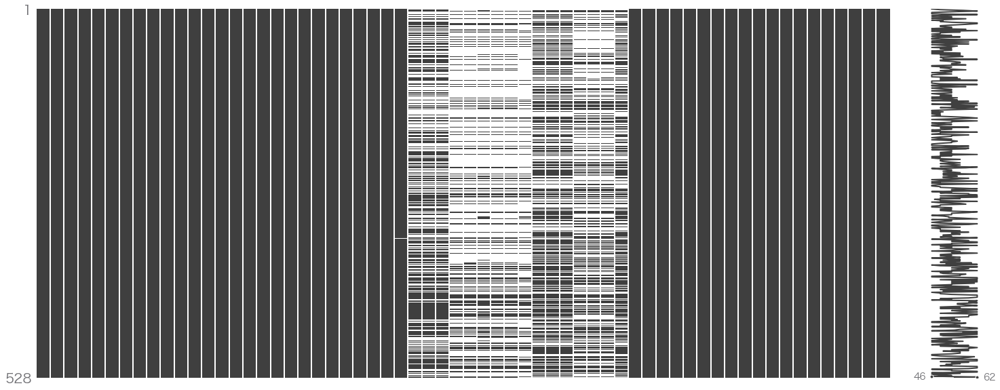

In [5]:
msno.matrix(raw)

As we can see, most columns with missing values have a large proportion missing. We can drop these columns from the data frame since imputing or interpolating that much data may substantially change these distributions and lead to inaccurate/weird predictions.

The "lymphocyte" column only has one missing value. We can delete the one case without a "lymphocyte" value.

In [6]:
# Copy original data to a new data frame
df = raw.copy()

# Delete columns with too much data missing
to_drop = check_missing(raw).index.tolist()[:-1]
df.drop(to_drop, axis=1, inplace=True)

# Drop row where "lymphocyte" is missing
df.dropna(subset=["lymphocyte"], inplace=True)

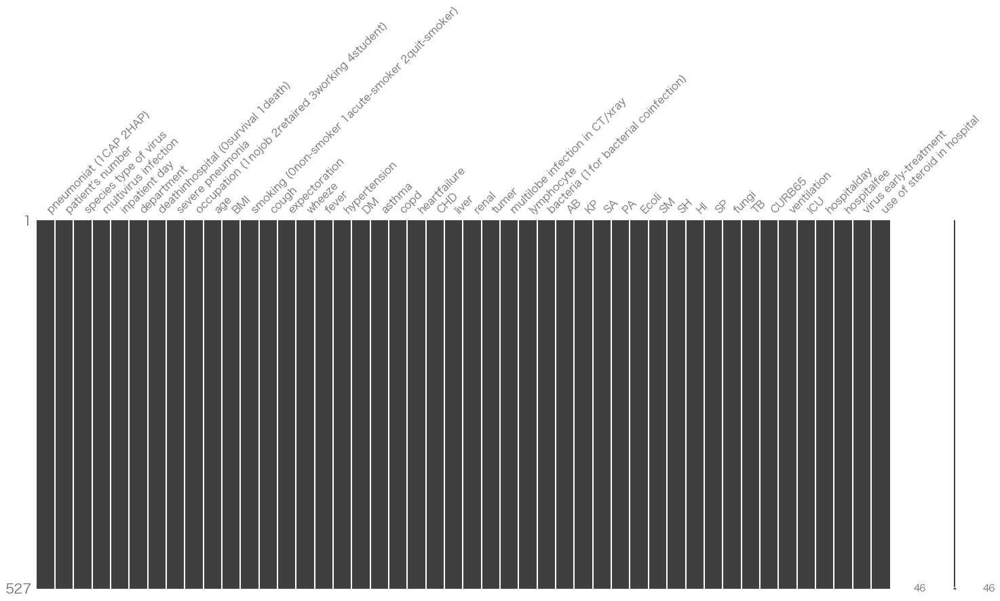

In [7]:
msno.matrix(df)

In [8]:
check_missing(df)

,total,percent


Now we no longer have missing values. 

#### Variable naming and value recoding
The graph above shows many variables with incredibly long names. If later we use one-hot encoding to convert categorical variables into numeric variables, new columns will get even longer names. To prevent that, let's rename certain columns. Since most variables bear specific clinical meanings, I'll refer to Guo et al.'s (2019) paper and do it on a case-by-case basis.

In [9]:
# pneumoniat (1CAP 2HAP)
# CAP: community acquired pneumonia; HAP: hospital acquired pneumonia

# Rename column
df = df.rename(columns={"pneumoniat (1CAP 2HAP)": "source"})

# Recode values
df["source"].replace({1: "CAP", 2: "HAP"}, inplace=True)

In [10]:
# patient's number

# Don't need it; drop it
df.drop("patient's number", axis=1, inplace=True)

In [11]:
# species type of virus
df = df.rename(columns={"species type of virus": "virus"})

In [12]:
# deathinhospital (0survival 1death)
df = df.rename(columns={"deathinhospital (0survival 1death)": "is_dead"})

In [13]:
# occupation (1nojob 2retaired 3working 4student)

# Rename column
df = df.rename(
    columns={"occupation (1nojob 2retaired 3working 4student)": "occupation"}
)

# Recode values
df["occupation"].replace(
    {1: "nojob", 2: "retired", 3: "working", 4: "student"}, inplace=True
)

In [14]:
# smoking (0non-smoker 1acute-smoker 2quit-smoker)

# Rename column
df = df.rename(columns={"smoking (0non-smoker 1acute-smoker 2quit-smoker)": "smoking"})

# Recode values
df["smoking"].replace(
    {0: "non-smoker", 1: "acute-smoker", 2: "quit-smoker"}, inplace=True
)

In [15]:
# multilobe infection in CT/xray
# Unclear what "1" and "2" meant; assume 1 = no, 2 = yes

# Rename column
df = df.rename(columns={"multilobe infection in CT/xray": "multilobular_infiltration"})

# Recode values
df["multilobular_infiltration"].replace({1: 0, 2: 1}, inplace=True)

In [16]:
# bacteria (1for bacterial coinfection)
df = df.rename(
    columns={"bacteria (1for bacterial coinfection)": "bacterial_coinfection"}
)

In [17]:
# virus early-treatment
df = df.rename(columns={"virus early-treatment": "early_treatment"})

In [18]:
# use of steroid in hospital
df = df.rename(columns={"use of steroid in hospital": "steroid_use"})

In [19]:
# Clean spaces
df.columns = (
    df.columns.str.strip()  # Remove spaces at the beginning and the end
    .str.replace(" ", "_")  # Replace other spaces with "_"
    .str.lower()
)

#### Data type conversion
Now let's look at the data type of each column.

In [20]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 527 entries, 0 to 527
Data columns (total 45 columns):
source                       527 non-null object
virus                        527 non-null object
multivirus_infection         527 non-null int64
inpatient_day                527 non-null object
department                   527 non-null object
is_dead                      527 non-null int64
severe_pneumonia             527 non-null int64
occupation                   527 non-null object
age                          527 non-null object
bmi                          527 non-null float64
smoking                      527 non-null object
cough                        527 non-null int64
expectoration                527 non-null int64
wheeze                       527 non-null int64
fever                        527 non-null int64
hypertension                 527 non-null int64
dm                           527 non-null int64
asthma                       527 non-null int64
copd                  

Not all columns have numeric values. Since most machine learning models only take numeric input, we need to convert them into numeric variables.

In [21]:
# Find columns with string values
df.select_dtypes(include=["object"]).columns

Index(['source', 'virus', 'inpatient_day', 'department', 'occupation', 'age',
       'smoking'],
      dtype='object')

Of course "source", "virus", "department", "occupation", "smoking", and "multilobular_infiltration" are strings. But why is "age" not numerical?

In [22]:
df["age"].unique()

array(['56-60', '86-90', '71-75', '66-70', '61-65', '<20', '76-80',
       '81-85', '20-25', '>90', '26-30', '41-45', '31-35', '46-50',
       '51-55', '36-40'], dtype=object)

That's because ages are put into bins of 5 years. To lose less information, we can use means or medians to recode these bins. However, the two categories "<20" and ">90" prevent us from doing so. The next best thing do is use one-hot encoding on "age", treating each bin as a discrete category. This allows us to find out later which age group is most vulnerable.

That means, we can one-hot encode all the columns above, except for "inpatient_day".

In [23]:
# One-hot encoding
df = pd.get_dummies(
    df,
    prefix=["source", "virus", "department", "occupation", "age", "smoking"],
    columns=["source", "virus", "department", "occupation", "age", "smoking"],
)

"inpatient_day" is the day on which a patient was committed to the hospital. We can convert strings into datetime objects for easier manipulation. The `parse()` function conveniently allows us to so without even explicitly specifying the date format.

In [24]:
df["inpatient_day"] = df["inpatient_day"].apply(lambda x: parse(x))

Daytime objects still cannot be directly used as input. As suggested by this Stack Overflow [answer]( https://stackoverflow.com/questions/16453644/regression-with-date-variable-using-scikit-learn), when we have many dates, we can convert them into the number of days since year 1 day 1. Of course these numbers will huge, but we can rescale them.

In [25]:
# Convert datetime to days since year 1 day 1
df["inpatient_day"] = df["inpatient_day"].map(dt.datetime.toordinal)

# Rescale using Z-scores
df["inpatient_day"] = preprocessing.scale(df["inpatient_day"])

#### Train/test split
Before exploring the data, let's do the train/test split first (saving 20% of data for testing and using the rest for model training). This is because we don't want to "peek" into the testing data before we train our models.

In [26]:
# Target variable: "is_dead"
y = df["is_dead"]

# Explanatory variables: all the rest
X = df.loc[:, df.columns != "is_dead"]

# Create training and testing datasets
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=465
)

### Data exploration

Our target variable is "is_dead", which is the binary outcome of each patient (`0`: survival; `1`: death).

#### Target variable

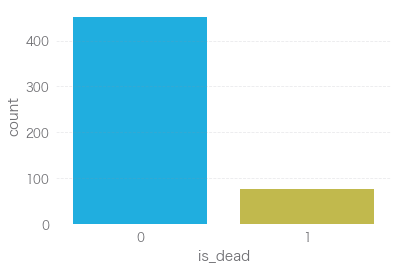

In [27]:
sns.countplot(y)
plt.show()

Patients' outcomes are imbalanced, with about 5 times more survived (at least for 90 days) than dead. We can deal with imbalanced data in a variety of aways, such as [resampling](https://datascience.stackexchange.com/questions/28360/how-to-fix-class-imbalance-in-training-sample?rq=1) (undersampling the majority class or oversampling the minority class) and [generating synthetic data](https://towardsdatascience.com/class-imbalance-a-classification-headache-1939297ff4a4). However, the imbalance here is not that extreme (see [When is unbalanced data really a problem in Machine Learning?](https://stats.stackexchange.com/questions/283170/when-is-unbalanced-data-really-a-problem-in-machine-learning)). When people talk about problematic cases, they are probably more thinking along the lines of fraud detection where only about, say, 0.001% of the transactions are fraudulent. Moreover, SVM and tree-based methods like Random Forest are robust to imbalanced data. Considering these, we may not need to take special measures here.

#### Explanatory variables
Let's visualize the distributions of all 145 explanatory variables.

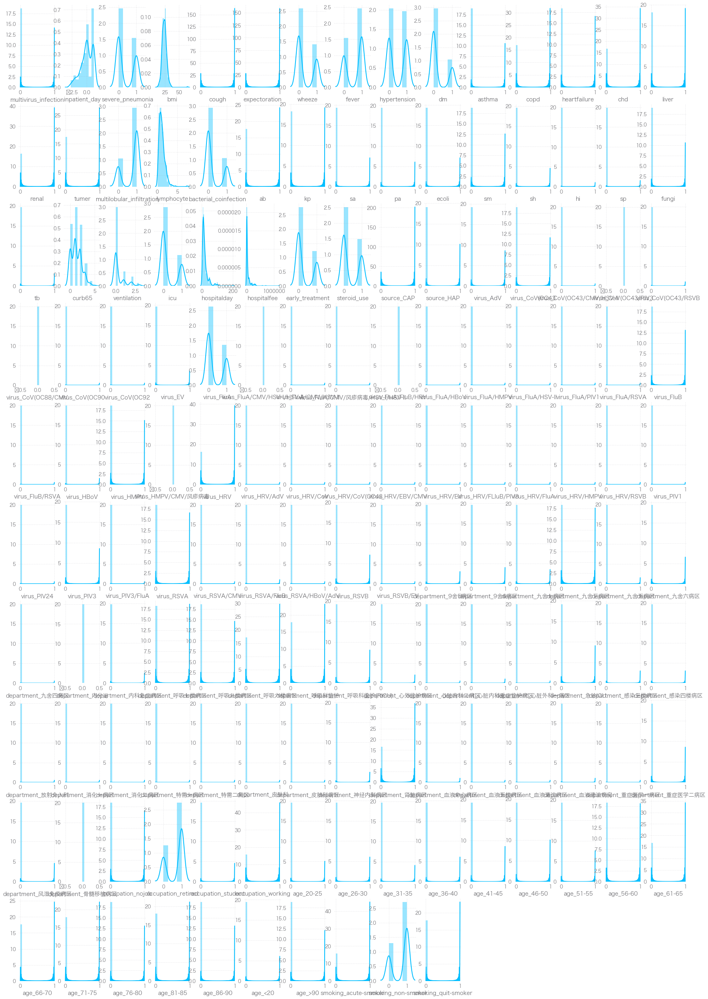

In [28]:
plt.figure(figsize=(10 * 3, 15 * 3))

i = 1
for col in X_train.columns:
    plt.subplot(10, 15, i)
    sns.distplot(X_train[col])
    i += 1

plt.tight_layout
plt.show()

Understandably, most variables are not normally distributed because they encode categorical information, such as whether a patient had a particular type of comorbidity, whether they tested positive in some clinical test, etc.

#### Correlation matrix
Let's look at pairwise correlations between all variables, including all explanatory variables and the outcome variable. (We need to perform some [tricks](http://cheng.logdown.com/posts/2016/09/01/827866) in order to display Chinese characters in the plots.)

In [29]:
# Concatenate explanatory and outcome variables
df_train = pd.concat([X_train, y_train.reindex(X_train.index)], axis=1)

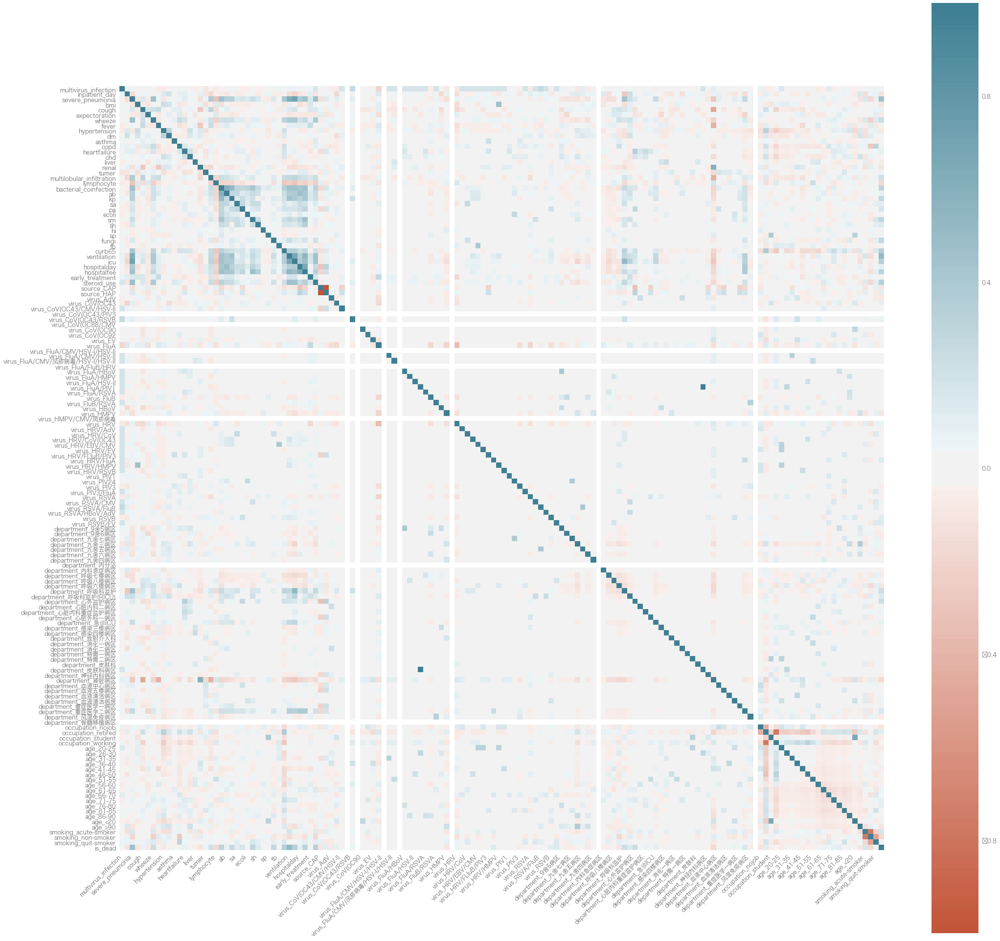

In [30]:
# Correlation among all variables
corr = df_train.corr()

# Plot Pearson correaltion coefficients on a heat map
plt.figure(figsize=(35, 35))

ax = sns.heatmap(
    corr,
    vmin=-1,
    vmax=1,
    center=0,
    cmap=sns.diverging_palette(20, 220, n=200),
    square=True,
)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment="right")

plt.show()

The good thing is, most features are uncorrelated with one another. However, only a few features are strongly correlated with our target variable, such as "severe_pneumonia", "ventilation", "icu", etc. This suggests that we should probably get rid of most explanatory variables in feature engineering.

### Feature engineering

#### Standardization
To achieve better model performance, we can standardize our feature vectors, including [one-hot vectors](https://datascience.stackexchange.com/questions/17540/make-seaborn-heatmap-bigger).

In [31]:
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

#### Principal Component Analysis (PCA)
First of all, let's see if we can summarize the data using a small number of principal components.

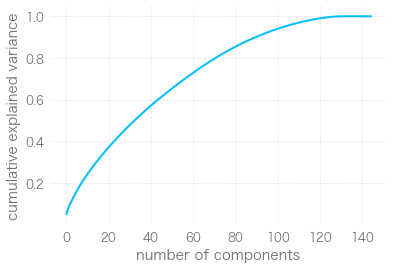

In [32]:
pca = PCA().fit(X_train)
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel("number of components")
plt.ylabel("cumulative explained variance");

However, this doesn't seem like the case. 

#### Lasso
We can use Lasso regularization to examine th importance of each feature.

In [33]:
# Lasso regularization
reg = LassoCV()
reg.fit(X_train, y_train)
print("Best alpha using built-in LassoCV: %f" % reg.alpha_)
print("Best score using built-in LassoCV: %f" % reg.score(X_train, y_train))
coef = pd.Series(reg.coef_, index=X.columns)

Best alpha using built-in LassoCV: 0.019920
Best score using built-in LassoCV: 0.453249


Lasso picked 23 variables and eliminated the other 122 variables


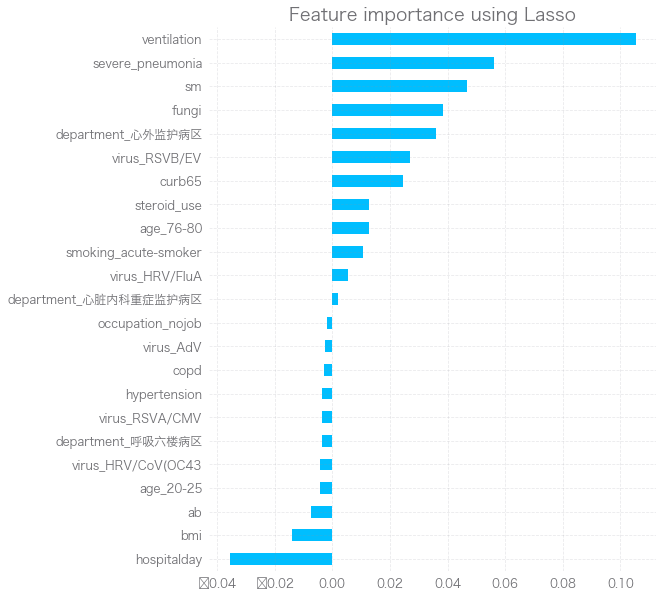

In [34]:
# Number of features picked and eliminated
print(
    "Lasso picked "
    + str(sum(coef != 0))
    + " variables and eliminated the other "
    + str(sum(coef == 0))
    + " variables"
)

# Plot feature importance (non-zero efficient)
imp_coef = coef.iloc[coef.nonzero()].sort_values()

plt.rcParams["figure.figsize"] = (8.0, 10.0)
imp_coef.plot(kind="barh")
plt.title("Feature importance using Lasso")

plt.savefig("feature_importance.png", bbox_inches="tight", dpi=500)

We can create a version of feature list with only these features. For some models, we can just use the selected features to make predictions. For models like Ridge and Lasso, since they already have built-in penalty for non-important features, we can use the full set of features.

In [35]:
# Select only the important features
X_lite = X[imp_coef.index.tolist()]

# Test/train split again
X_train_lite, X_test_lite, y_train, y_test = train_test_split(
    X_lite, y, test_size=0.2, random_state=465
)

## Regularized regression

### Hyperparameter tuning

In [36]:
# Use K-fold cross validation to select hyperparameters
lasso_cv = LassoCV(alphas=[0.01, 0.1, 1.0, 10.0])

ridge_cv = RidgeCV(alphas=[0.01, 0.1, 1.0, 10.0])

elastic_cv = ElasticNetCV(
    eps=None,
    n_alphas=None,
    alphas=[0.01, 0.1, 1.0, 10.0],
    l1_ratio=[0.1, 0.5, 0.7, 0.9, 0.95, 0.99, 1.0],
    cv=5,
)


print("The best alpha for Lasso is {}.\n".format(lasso_cv.fit(X_train, y_train).alpha_))

print("The best alpha for Ridge is {}.\n".format(ridge_cv.fit(X_train, y_train).alpha_))

print(
    "The best alpha for ElasticNet is {} and the best l1_ratio is {}.".format(
        elastic_cv.fit(X_train, y_train).alpha_,
        elastic_cv.fit(X_train, y_train).l1_ratio_,
    )
)

The best alpha for Lasso is 0.01.

The best alpha for Ridge is 10.0.

The best alpha for ElasticNet is 0.1 and the best l1_ratio is 0.1.


### Train models

In [37]:
# Create model objects
lasso = Lasso(alpha=0.01)
ridge = Ridge(alpha=10.0)
elastic = ElasticNet(alpha=0.1, l1_ratio=0.1)

# Estimate coefficients
lasso.fit(X_train, y_train)
ridge.fit(X_train, y_train)
elastic.fit(X_train, y_train)

ElasticNet(alpha=0.1, copy_X=True, fit_intercept=True, l1_ratio=0.1,
           max_iter=1000, normalize=False, positive=False, precompute=False,
           random_state=None, selection='cyclic', tol=0.0001, warm_start=False)

In [38]:
# 10-fold cross validation
scores_lasso = cross_val_score(
    lasso, X_train, y_train, scoring="neg_mean_squared_error", cv=10
)
rmse_lasso = np.sqrt(-scores_lasso)

scores_ridge = cross_val_score(
    ridge, X_train, y_train, scoring="neg_mean_squared_error", cv=10
)
rmse_ridge = np.sqrt(-scores_ridge)

scores_elastic = cross_val_score(
    elastic, X_train, y_train, scoring="neg_mean_squared_error", cv=10
)
rmse_elastic = np.sqrt(-scores_elastic)

print(
    "For Lasso regression: \nRMSE of each fold is {} and the mean is {}.".format(
        rmse_lasso, rmse_lasso.mean()
    )
)

print(
    "\nFor Ridge regression: \nRMSE of each fold is {} and the mean is {}.".format(
        rmse_ridge, rmse_ridge.mean()
    )
)

print(
    "\nFor ElasticNet regression: \nRMSE of each fold is {} and the mean is {}.".format(
        rmse_elastic, rmse_elastic.mean()
    )
)

For Lasso regression: 
RMSE of each fold is [0.29359521 0.30026376 0.31228182 0.28455459 0.26900877 0.27913858
 0.42941799 0.2516546  0.23534247 0.27873547] and the mean is 0.293399325168371.

For Ridge regression: 
RMSE of each fold is [0.35531888 0.34923882 0.31944456 0.2904052  0.27147369 0.28918844
 0.45380376 0.29387427 0.26222993 0.4335783 ] and the mean is 0.3318555840028238.

For ElasticNet regression: 
RMSE of each fold is [0.28595006 0.29465534 0.31428694 0.28707886 0.2675122  0.28315793
 0.42771694 0.25073399 0.23157855 0.23532809] and the mean is 0.28779988869733725.


### Evaluate models

In [39]:
# Make predictions
predict_lasso = lasso.predict(X_test)
predict_ridge = ridge.predict(X_test)
predict_elastic = elastic.predict(X_test)

In [40]:
# Evaluate predictions
rmse_test_lasso = np.sqrt(metrics.mean_squared_error(y_test, predict_lasso))
rmse_test_ridge = np.sqrt(metrics.mean_squared_error(y_test, predict_ridge))
rmse_test_elastic = np.sqrt(metrics.mean_squared_error(y_test, predict_elastic))

print("Lasso regression: RMSE = {}.\n".format(rmse_test_lasso))
print("Ridge regression: RMSE = {}.\n".format(rmse_test_ridge))
print("Elastic regression: RMSE = {}.\n".format(rmse_test_elastic))

Lasso regression: RMSE = 0.2998298827735593.

Ridge regression: RMSE = 0.3040028286582969.

Elastic regression: RMSE = 0.29925700149822104.



None of the models are really good... 

## Naïve Bayes

## KNN

## Random Forest

## Boosting

## Summary

### Features
What kind of patients are more likely to die?

### Techniques
What kind models are most accurate?